In [25]:
import numpy as np
import random
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from collections import deque
from tabulate import tabulate

# Step 1: Define a simpler Environment
class FlowTableEnv:
    def __init__(self, table_size=10):  # Reduced table size
        self.table_size = table_size
        self.flow_table = []
        self.new_flow = None
        self.observation_space = (table_size + 1) * 2  # Each flow has 2 attributes now
        self.action_space = table_size

    def reset(self):
        self.flow_table = [self._generate_flow() for _ in range(self.table_size)]
        self.new_flow = self._generate_flow()
        return self._get_state()

    def _generate_flow(self):
        return {
            'priority': random.randint(1, 5),  # Simplified range
            'usage': random.randint(1, 5),
            'age': random.randint(1, 5),
            'packet_count': random.randint(1, 5)
        }

    def _get_state(self):
        state = []
        for flow in self.flow_table:
            state.extend([flow['priority'], flow['usage']])
        state.extend([self.new_flow['priority'], self.new_flow['usage']])
        return np.array(state, dtype=np.float32)

    def step(self, action):
        if action < len(self.flow_table):
            reward = self._calculate_reward(action)
            self.flow_table[action] = self.new_flow
        else:
            reward = -1
        
        self.new_flow = self._generate_flow()
        return self._get_state(), reward, False

    def _calculate_reward(self, action):

        old_flow = self.flow_table[action]
        new_flow = self.new_flow

        # Weights for components of the reward function [priority, usage, age, packet_count]
        # Higher priority, lower usage, lower age, lower packet_count is better
        weights = {'priority': 0.3, 'usage': 0.5, 'age': 0.2, 'packet_count': 0.4}

        old_flow_value = sum(weights[key] * old_flow[key] for key in weights)
        new_flow_value = sum(weights[key] * new_flow[key] for key in weights)  

        # Calculate raw reward
        raw_reward = new_flow_value - old_flow_value
        # Normalize reward to [-5, 5] range
        max_possible_reward = 10
        normalized_reward = (raw_reward / max_possible_reward) * 5
        
        return normalized_reward
    
    def print_flow_table(self):
        # Create headers and table data
        headers = ["Index", "Priority", "Usage"]
        table_data = [[i, flow['priority'], flow['usage']] 
                     for i, flow in enumerate(self.flow_table)]
        
        # Add new flow at the bottom
        table_data.append(["New Flow", self.new_flow['priority'], self.new_flow['usage']])
        
        # Print formatted table
        print(tabulate(table_data, headers=headers, tablefmt="grid"))


In [21]:


# Step 2: Double DQN Agent
class DDQNAgent:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=10000)  # Replay buffer
        self.gamma = 0.95  # Discount factor
        self.epsilon = 1.0  # Exploration rate
        self.epsilon_min = 0.01
        self.epsilon_decay = 0.995
        self.batch_size = 128
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model = self._build_model().to(self.device)
        self.target_model = self._build_model().to(self.device)
        self.target_model.load_state_dict(self.model.state_dict())
        self.optimizer = optim.Adam(self.model.parameters(), lr=0.001)
        self.update_target_counter = 0
        self.target_update_freq = 10
        print(f"Using device: {self.device}")

    def _build_model(self):
        return nn.Sequential(
            nn.Linear(self.state_size, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, self.action_size)
        )

    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))

    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            return torch.argmax(self.model(state)).item()

    def replay(self):
        if len(self.memory) < self.batch_size:
            return 0

        minibatch = random.sample(self.memory, self.batch_size)
        states = torch.FloatTensor([t[0] for t in minibatch]).to(self.device)
        actions = torch.LongTensor([t[1] for t in minibatch]).to(self.device)
        rewards = torch.FloatTensor([t[2] for t in minibatch]).to(self.device)
        next_states = torch.FloatTensor([t[3] for t in minibatch]).to(self.device)
        dones = torch.FloatTensor([t[4] for t in minibatch]).to(self.device)

        # Get actions from main network for next states
        next_actions = torch.argmax(self.model(next_states), dim=1)
        
        # Get Q-values from target network for next states
        with torch.no_grad():
            target_q_values = self.target_model(next_states)
            max_target_q = target_q_values[range(self.batch_size), next_actions]
            targets = rewards + (1 - dones) * self.gamma * max_target_q

        # Get current Q-values and update them
        current_q = self.model(states)
        current_q_actions = current_q[range(self.batch_size), actions]

        # Calculate loss and optimize
        loss = nn.MSELoss()(current_q_actions, targets)
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

        # Update target network periodically
        self.update_target_counter += 1
        if self.update_target_counter % self.target_update_freq == 0:
            self.target_model.load_state_dict(self.model.state_dict())

        # Decay epsilon
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

        return loss.item()

    def train(self, state, action, reward, next_state, done):
        self.remember(state, action, reward, next_state, done)
        return self.replay()


Using device: cuda

Episode 1 Initial State:
+----------+------------+---------+
| Index    |   Priority |   Usage |
+==========+============+=========+
| 0        |          2 |       1 |
+----------+------------+---------+
| 1        |          1 |       5 |
+----------+------------+---------+
| 2        |          3 |       5 |
+----------+------------+---------+
| 3        |          5 |       1 |
+----------+------------+---------+
| 4        |          1 |       1 |
+----------+------------+---------+
| 5        |          4 |       3 |
+----------+------------+---------+
| 6        |          3 |       3 |
+----------+------------+---------+
| 7        |          4 |       1 |
+----------+------------+---------+
| 8        |          1 |       1 |
+----------+------------+---------+
| 9        |          3 |       2 |
+----------+------------+---------+
| New Flow |          3 |       3 |
+----------+------------+---------+

Step 1:
Action taken: 1
+----------+------------+-----

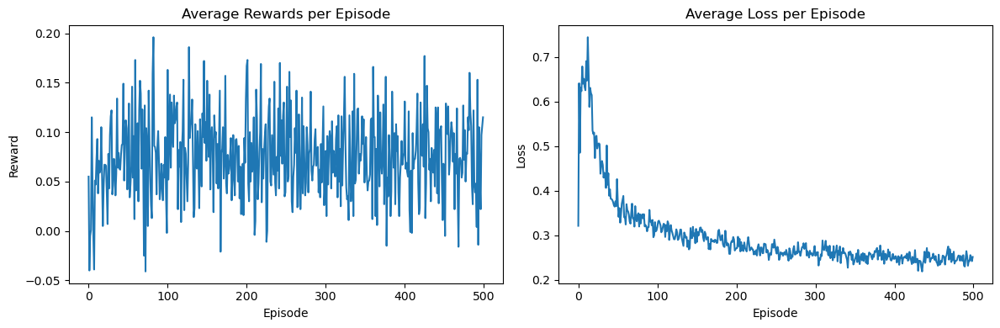

In [26]:
# Step 3: Quick DDQN Training with Visualization
env = FlowTableEnv()
state_size = env.observation_space
action_size = env.action_space
agent = DDQNAgent(state_size, action_size)

episodes = 500  # Reduced episodes
rewards_history = []
losses_history = []

for episode in range(episodes):
    state = env.reset()
    episode_rewards = []
    episode_losses = []
    
    print(f"\nEpisode {episode + 1} Initial State:")
    env.print_flow_table()
    
    for step in range(50):  # Reduced steps per episode
        action = agent.act(state)
        next_state, reward, done = env.step(action)
        loss = agent.train(state, action, reward, next_state, done)
        
        print(f"\nStep {step + 1}:")
        print(f"Action taken: {action}")
        env.print_flow_table()
        print(f"Reward: {reward}")
        print(f"Loss: {loss}")
        
        episode_rewards.append(reward)
        episode_losses.append(loss)
        state = next_state
    
    avg_reward = np.mean(episode_rewards)
    avg_loss = np.mean(episode_losses)
    rewards_history.append(avg_reward)
    losses_history.append(avg_loss)
    print(f"\nEpisode {episode + 1}/{episodes} Summary:")
    print(f"Average Reward: {avg_reward:.2f}")
    print(f"Average Loss: {avg_loss:.4f}")
    print(f"Final Epsilon: {agent.epsilon:.4f}")

# Plotting results
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(rewards_history)
plt.title('Average Rewards per Episode')
plt.xlabel('Episode')
plt.ylabel('Reward')

plt.subplot(1, 2, 2)
plt.plot(losses_history)
plt.title('Average Loss per Episode')
plt.xlabel('Episode')
plt.ylabel('Loss')

plt.tight_layout()
plt.show()


In [13]:
# TODO: Upgrade PPO Agent
class PPOAgent:
    def __init__(self, state_size, action_size, hidden_size=64, clip_epsilon=0.2, c1=1.0, c2=0.01):
        self.state_size = state_size
        self.action_size = action_size
        self.clip_epsilon = clip_epsilon
        self.c1 = c1  # Value function coefficient
        self.c2 = c2  # Entropy coefficient
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        # Actor network (policy)
        self.actor = nn.Sequential(
            nn.Linear(state_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, action_size),
            nn.Softmax(dim=-1)
        ).to(self.device)

        # Critic network (value)
        self.critic = nn.Sequential(
            nn.Linear(state_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, 1)
        ).to(self.device)

        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=3e-4)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=1e-3)

    def act(self, state):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            probs = self.actor(state)
            action = torch.multinomial(probs, 1).item()
            log_prob = torch.log(probs[0][action])
            return action, log_prob.item()

    def get_action(self, state):
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            probs = self.actor(state)
            action = torch.multinomial(probs, 1).item()
            return action, probs[0][action].item()

    def train(self, states, actions, rewards, next_states, old_probs):
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        rewards = torch.FloatTensor(rewards).to(self.device)
        next_states = torch.FloatTensor(next_states).to(self.device)
        old_probs = torch.FloatTensor(old_probs).to(self.device)

        # Compute advantage
        with torch.no_grad():
            values = self.critic(states)
            next_values = self.critic(next_states)
            advantages = rewards + 0.99 * next_values - values

        # PPO update
        for _ in range(50):  # Multiple epochs of training
            # Actor loss
            probs = self.actor(states)
            new_probs = probs.gather(1, actions.unsqueeze(1)).squeeze()
            ratio = new_probs / old_probs

            surr1 = ratio * advantages
            surr2 = torch.clamp(ratio, 1 - self.clip_epsilon, 1 + self.clip_epsilon) * advantages
            actor_loss = -torch.min(surr1, surr2).mean()

            # Value loss
            value_pred = self.critic(states)
            value_target = rewards + 0.99 * self.critic(next_states)
            value_loss = nn.MSELoss()(value_pred, value_target.detach())

            # Entropy bonus
            entropy = -(probs * torch.log(probs + 1e-10)).sum(dim=-1).mean()

            # Total loss
            total_loss = actor_loss + self.c1 * value_loss - self.c2 * entropy

            # Update networks
            self.actor_optimizer.zero_grad()
            self.critic_optimizer.zero_grad()
            total_loss.backward()
            self.actor_optimizer.step()
            self.critic_optimizer.step()

        return total_loss.item()

class Memory:
    def __init__(self):
        self.states = []
        self.actions = []
        self.rewards = []
        self.next_states = []
        self.probs = []

    def push(self, state, action, reward, next_state, prob):
        self.states.append(state)
        self.actions.append(action)
        self.rewards.append(reward)
        self.next_states.append(next_state)
        self.probs.append(prob)

    def clear(self):
        self.states.clear()
        self.actions.clear()
        self.rewards.clear()
        self.next_states.clear()
        self.probs.clear()

    def get_all(self):
        return (
            np.array(self.states),
            np.array(self.actions),
            np.array(self.rewards),
            np.array(self.next_states),
            np.array(self.probs)
        )


In [ ]:
# Step 3: Quick PPO Training with Visualization 
# Initialize PPO agent and environment
env = FlowTableEnv()
state_dim = env.observation_space
action_dim = env.action_space
ppo_agent = PPOAgent(state_dim, action_dim)

episodes = 500
steps_per_episode = 50
batch_size = 32

rewards_history_ppo = []
losses_history_ppo = []

for episode in range(episodes):
    state = env.reset()
    episode_rewards = []
    episode_losses = []
    
    print(f"\nEpisode {episode + 1} Initial State:")
    env.print_flow_table()
    
    # Collect trajectory data
    states, actions, rewards, next_states, log_probs = [], [], [], [], []
    
    for step in range(steps_per_episode):
        action, log_prob = ppo_agent.act(state)
        next_state, reward, done = env.step(action)
        
        # Store transition
        states.append(state)
        actions.append(action)
        rewards.append(reward)
        next_states.append(next_state)
        log_probs.append(log_prob)
        
        print(f"\nStep {step + 1}:")
        print(f"Action taken: {action}")
        env.print_flow_table()
        print(f"Reward: {reward}")
        
        episode_rewards.append(reward)
        state = next_state
        
        if len(states) >= batch_size:
            # Update PPO agent
            loss = ppo_agent.train(states, actions, rewards, next_states, log_probs)
            episode_losses.append(loss)
            print(f"Loss: {loss}")
            
            # Clear trajectory data
            states, actions, rewards, next_states, log_probs = [], [], [], [], []
    
    # Final update with remaining data if any
    if states:
        loss = ppo_agent.update(states, actions, rewards, next_states, log_probs)
        episode_losses.append(loss)
    
    avg_reward = np.mean(episode_rewards)
    avg_loss = np.mean(episode_losses) if episode_losses else 0
    rewards_history_ppo.append(avg_reward)
    losses_history_ppo.append(avg_loss)
    
    print(f"\nEpisode {episode + 1}/{episodes} Summary:")
    print(f"Average Reward: {avg_reward:.2f}")
    print(f"Average Loss: {avg_loss:.4f}")

# Plotting PPO results
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(rewards_history_ppo)
plt.title('PPO Average Rewards per Episode')
plt.xlabel('Episode')
plt.ylabel('Reward')

plt.subplot(1, 2, 2)
plt.plot(losses_history_ppo)
plt.title('PPO Average Loss per Episode')
plt.xlabel('Episode')
plt.ylabel('Loss')

plt.tight_layout()
plt.show()
